<a href="https://colab.research.google.com/github/PIPCE/Advanced-Analytics-in-Business/blob/assignment2_ce/Predicting_insta_likes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Libraries

In [ ]:
# import libraries
import pandas as pd
import numpy as np
from six.moves import zip
import pip
import shutil
import os
import matplotlib.pyplot as plt

# Import Keras libraries
import keras
import tensorflow as tf
from keras.preprocessing.image import ImageDataGenerator
from keras.applications import VGG19
from tensorflow.keras import layers, models, Model

# Code to read csv file into Colaboratory:
!pip
install - U - q
PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth, drive
from oauth2client.client import GoogleCredentials

Mounted at /content/drive


# Load Metadata 

In [ ]:
fileDownloaded = Gdrive.CreateFile({'id':'1gJnArj2EcyWHG2j95XCro8KOvC3ggkQD'})
fileDownloaded.GetContentFile('food_only_recipes.csv')
df = pd.read_csv('food_only_recipes.csv', delimiter=',' )
df['photo'] = '/content/drive/MyDrive/Colab_Notebooks/recipes/train/' + df['photo_id'] + '.png'
df.head()
# Dataset is now stored in a Pandas Dataframe

,photo_id,url,may_be,likes,timestamp,scraped_at,diff,tag_healthy,tag_tasty,tag_dinner,tag_vegan,tag_breakfast,tag_lunch,tag_dessert,tag_baking,tag_cake,tag_easyrecipes,tag_chocolate,tag_vegetarian,tag_sweet,tag_pasta,tag_diet,tag_fitness,tag_glutenfree,tag_chicken,tag_weightloss,tag_veganfood,tag_plantbased,tag_cheese,tag_italianfood,tag_salad,tag_keto,tag_pastry,tag_fresh,tag_snack,tag_cookies,tag_comfortfood,tag_lowcarb,tag_protein,tag_bread,...,tag_veganrecipe,tag_dairyfree,tag_sweettooth,tag_ketodiet,tag_lemon,tag_cheesecake,tag_snacks,tag_ilovefood,tag_food52,tag_foodbloggers,tag_family,tag_avocado,tag_cakes,tag_curry,tag_banana,tag_gastronomy,tag_chocolat,tag_oats,tag_bbq,tag_italia,tag_pastalover,tag_icecream,tag_spicy,tag_smoothie,tag_asianfood,tag_garlic,tag_streetfood,tag_travel,tag_salmon,tag_egg,tag_oatmeal,tag_natural,tag_beef,tag_noodles,tag_italian,tag_drinks,tag_steak,tag_sandwich,tag_strawberry,photo
0,CMPELQqh_nh,https://www.instagram.com/p/CMPELQqh_nh/,dessert and indoor,3,2021-03-10T10:47:18,2021-03-10T11:48:52,1.03,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...
1,CMPEHqppR-t,https://www.instagram.com/p/CMPEHqppR-t/,pasta and indoor,3,2021-03-10T10:46:48,2021-03-10T11:48:59,1.04,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...
2,CMPEBY9Buko,https://www.instagram.com/p/CMPEBY9Buko/,cake and indoor,2,2021-03-10T10:45:57,2021-03-10T11:49:08,1.05,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...
3,CMPEAvhF9i1,https://www.instagram.com/p/CMPEAvhF9i1/,food,1,2021-03-10T10:45:52,2021-03-10T11:49:12,1.06,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...
4,CMPD73jJssJ,https://www.instagram.com/p/CMPD73jJssJ/,dessert,2,2021-03-10T10:45:12,2021-03-10T11:49:16,1.07,0,0,0,0,0,0,1,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...


## Remove Corrupted Files
Run the code block below only once.

In [ ]:
#code to find bad images
#import os
#from PIL import Image
#import cv2
#bad_list=[]
#folder_path = '/content/drive/MyDrive/Colab_Notebooks/recipes/train/'
#extensions = []

#for filee in os.listdir(folder_path):
#    file_path = os.path.join(folder_path, filee)
#    print('** Path: {}  **'.format(file_path), end="\r", flush=True)
#    try:
#      img=cv2.imread(file_path)
#      size=img.shape
#    except:
#      print(f'file {file_path} is not a valid image file ')
#      bad_list.append(file_path)                

#print(bad_list)

In [ ]:
indexNames = df[df['photo_id'] == 'CMmV2A2sBvY'].index
# Delete this row index from dataFrame
df.drop(indexNames , inplace=True)

# Train-Test Split

Run only once to create the subfolders with the images.

In [ ]:
test_ratio = 0.10

os.makedirs(root_dir +'train/')
os.makedirs(root_dir +'test/')

photo = df['photo']
# Creating partitions of the data after shuffeling
np.random.shuffle(photo)
train_FileNames, test_FileNames = np.split(np.array(photo),
                                                      [int(len(photo)* (1 - test_ratio))])


train_FileNames = [root_dir+'/'+ name for name in train_FileNames.tolist()]
test_FileNames = [root_dir+'/' + name for name in test_FileNames.tolist()]

print('Total images: ', len(photo))
print('Training: ', len(train_FileNames))
print('Testing: ', len(test_FileNames))

# Copy-pasting images
for name in train_FileNames:
    shutil.copy(name, root_dir +'train/')

for name in test_FileNames:
    shutil.copy(name, root_dir +'test/')

## Create Target Variable

In [ ]:
df['time'] = np.where(df['diff'] >= 36, 36, df['diff'])
df['time'].describe()
df['likes per hour'] = df['likes']/df['time']
df.head()

,photo_id,url,may_be,likes,timestamp,scraped_at,diff,tag_healthy,tag_tasty,tag_dinner,tag_vegan,tag_breakfast,tag_lunch,tag_dessert,tag_baking,tag_cake,tag_easyrecipes,tag_chocolate,tag_vegetarian,tag_sweet,tag_pasta,tag_diet,tag_fitness,tag_glutenfree,tag_chicken,tag_weightloss,tag_veganfood,tag_plantbased,tag_cheese,tag_italianfood,tag_salad,tag_keto,tag_pastry,tag_fresh,tag_snack,tag_cookies,tag_comfortfood,tag_lowcarb,tag_protein,tag_bread,...,tag_ketodiet,tag_lemon,tag_cheesecake,tag_snacks,tag_ilovefood,tag_food52,tag_foodbloggers,tag_family,tag_avocado,tag_cakes,tag_curry,tag_banana,tag_gastronomy,tag_chocolat,tag_oats,tag_bbq,tag_italia,tag_pastalover,tag_icecream,tag_spicy,tag_smoothie,tag_asianfood,tag_garlic,tag_streetfood,tag_travel,tag_salmon,tag_egg,tag_oatmeal,tag_natural,tag_beef,tag_noodles,tag_italian,tag_drinks,tag_steak,tag_sandwich,tag_strawberry,photo,photo_train,time,likes per hour
0,CMPELQqh_nh,https://www.instagram.com/p/CMPELQqh_nh/,dessert and indoor,3,2021-03-10T10:47:18,2021-03-10T11:48:52,1.03,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPELQqh_nh.png,1.03,2.912621
1,CMPEHqppR-t,https://www.instagram.com/p/CMPEHqppR-t/,pasta and indoor,3,2021-03-10T10:46:48,2021-03-10T11:48:59,1.04,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPEHqppR-t.png,1.04,2.884615
2,CMPEBY9Buko,https://www.instagram.com/p/CMPEBY9Buko/,cake and indoor,2,2021-03-10T10:45:57,2021-03-10T11:49:08,1.05,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPEBY9Buko.png,1.05,1.904762
3,CMPEAvhF9i1,https://www.instagram.com/p/CMPEAvhF9i1/,food,1,2021-03-10T10:45:52,2021-03-10T11:49:12,1.06,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPEAvhF9i1.png,1.06,0.943396
4,CMPD73jJssJ,https://www.instagram.com/p/CMPD73jJssJ/,dessert,2,2021-03-10T10:45:12,2021-03-10T11:49:16,1.07,0,0,0,0,0,0,1,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPD73jJssJ.png,1.07,1.869159


# Data Generator

Creating training and validation set and do image augmentation.

In [ ]:
directory = '/content/drive/MyDrive/Colab_Notebooks/recipes/train/'


# size of the image: 224*224 pixels
pic_size = 224
rescale_size = 1./255


train_datagen = ImageDataGenerator(
    rescale = rescale_size, # rescales the pixels such that their brightness ranges from 0 to 1
    validation_split = 0.20, # portion of images set aside for validation
    shear_range = 10, # randomly displaces each point in fixed direction
    brightness_range = (0.75, 1.25), # randomly zooms inside pictures
    horizontal_flip = True  # randomly flips the image horizontally
)

valid_datagen=ImageDataGenerator(rescale = rescale_size,validation_split=0.20)

train_generator=train_datagen.flow_from_dataframe(
    df, 
    directory,
    x_col = 'photo',
    y_col = 'likes per hour',
    target_size=(pic_size, pic_size),
    batch_size = 32,
    class_mode='raw',
    subset = 'training')

validation_generator=valid_datagen.flow_from_dataframe(
    df,
    directory,
    x_col = 'photo',
    y_col = 'likes per hour',
    target_size=(pic_size, pic_size),
    batch_size = 32,
    class_mode='raw',
    subset = 'validation')

/usr/local/lib/python3.7/dist-packages/keras_preprocessing/image/dataframe_iterator.py:282: UserWarning: Found 1131 invalid image filename(s) in x_col="photo". These filename(s) will be ignored.
  .format(n_invalid, x_col)


Found 8128 validated image filenames.
Found 2032 validated image filenames.


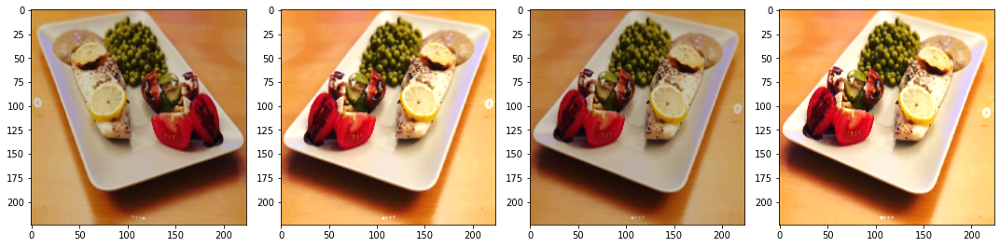

In [ ]:
# check whether training images are augmented (they should be)
augmented_images = [train_generator[5][0][0] for i in range(4)]

fig, axes = plt.subplots(1, 4, figsize=(15,15))
for img, ax in zip(augmented_images, axes):
    ax.imshow(img)
plt.tight_layout()
plt.show()

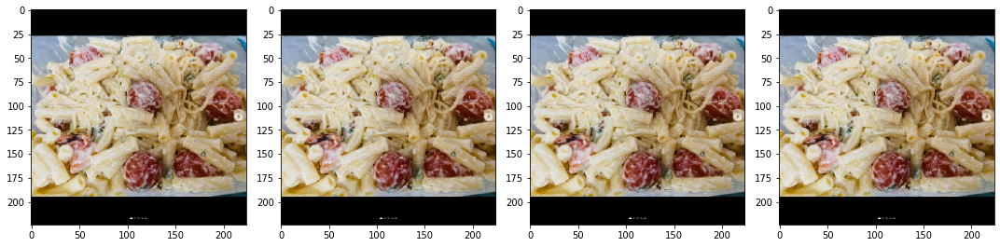

In [ ]:
# check whether validation images are augmented (they should not be)
augmented_images = [validation_generator[5][0][0] for i in range(4)]

fig, axes = plt.subplots(1, 4, figsize=(15,15))
for img, ax in zip(augmented_images, axes):
    ax.imshow(img)
plt.tight_layout()
plt.show()

# Building the Model

## Transfer Model

In [ ]:
inputs = keras.layers.Input(shape=(224, 224, 3))
base_model = VGG19(include_top = False, weights = 'imagenet', input_tensor=inputs)


# Rebuild top (still need to finetune the layers to be added)
x = base_model.output
x = keras.layers.GlobalAveragePooling2D(name="avg_pool")(x)
x = keras.layers.Dense(512, activation = "relu")(x)
top_dropout_rate = 0.4
x = layers.Dropout(top_dropout_rate, name="top_dropout")(x)
x = layers.Flatten()(x)
predictions = layers.Dense(1, name="pred")(x)


# Create the model that we will train
model = keras.Model(inputs = base_model.input, outputs = predictions, name="VGG19")

# We train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# Define alternative optimizer (for now, we use rmsprop)
adam = tf.optimizers.Adam()

# Compile
model.compile(
        optimizer=adam, loss="mean_absolute_error", metrics=['mape', 'mae', 'mse']
    )

Model_transfer_learning_history = model.fit(
        train_generator,
        epochs=10,
        validation_data=validation_generator,
    )

Epoch 1/10
254/254 [==============================] - 10364s 41s/step - loss: 6.4760 - mape: 183.6269 - mae: 6.4760 - mse: 399.7441 - val_loss: 5.5931 - val_mape: 194.6162 - val_mae: 5.5931 - val_mse: 238.4520
Epoch 2/10
254/254 [==============================] - 287s 1s/step - loss: 6.2145 - mape: 165.3472 - mae: 6.2145 - mse: 361.9700 - val_loss: 5.5268 - val_mape: 152.4873 - val_mae: 5.5268 - val_mse: 242.1890
Epoch 3/10
254/254 [==============================] - 290s 1s/step - loss: 6.0173 - mape: 160.2593 - mae: 6.0173 - mse: 344.9497 - val_loss: 5.5331 - val_mape: 160.0932 - val_mae: 5.5331 - val_mse: 241.1841
Epoch 4/10
254/254 [==============================] - 293s 1s/step - loss: 5.9081 - mape: 171.9572 - mae: 5.9081 - mse: 306.9863 - val_loss: 5.5237 - val_mape: 146.0744 - val_mae: 5.5237 - val_mse: 242.5365
Epoch 5/10
254/254 [==============================] - 294s 1s/step - loss: 6.0767 - mape: 165.9112 - mae: 6.0767 - mse: 317.3437 - val_loss: 5.5253 - val_mape: 138.7938 

In [ ]:
model.save('/content/drive/MyDrive/Colab_Notebooks/Models/VGG19.pb')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Colab_Notebooks/Models/VGG19.pb/assets


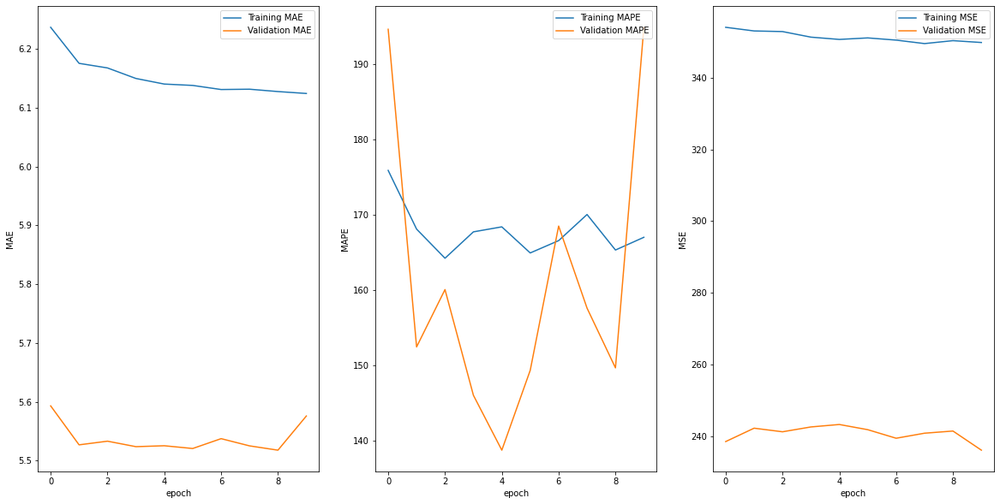

Average training MAE is 6.151942729949951
Average validation MAE is 5.537880802154541
Average training MAPE is 167.83717346191406
Average validation MAPE is 161.21858673095704
Average training MSE is 351.3585144042969
Average validation MSE is 240.6967559814453


In [ ]:
# Evaluate metrics

plt.figure(figsize=(20,10))
plt.subplot(1, 3, 1)
plt.ylabel('MAE')
plt.xlabel('epoch')
plt.plot(Model_transfer_learning_history.history['mae'], label='Training MAE')
plt.plot(Model_transfer_learning_history.history['val_mae'], label='Validation MAE')
plt.legend(loc='upper right')

plt.subplot(1, 3, 2)
plt.ylabel('MAPE')
plt.xlabel('epoch')
plt.plot(Model_transfer_learning_history.history['mape'], label='Training MAPE')
plt.plot(Model_transfer_learning_history.history['val_mape'], label='Validation MAPE')
plt.legend(loc='upper right')

plt.subplot(1, 3, 3)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.plot(Model_transfer_learning_history.history['mse'], label='Training MSE')
plt.plot(Model_transfer_learning_history.history['val_mse'], label='Validation MSE')
plt.legend(loc='upper right')

plt.show()

print('Average training MAE is {}'.format(np.average(Model_transfer_learning_history.history['mae'])))
print('Average validation MAE is {}'.format(np.average(Model_transfer_learning_history.history['val_mae'])))

print('Average training MAPE is {}'.format(np.average(Model_transfer_learning_history.history['mape'])))
print('Average validation MAPE is {}'.format(np.average(Model_transfer_learning_history.history['val_mape'])))

print('Average training MSE is {}'.format(np.average(Model_transfer_learning_history.history['mse'])))
print('Average validation MSE is {}'.format(np.average(Model_transfer_learning_history.history['val_mse'])))

## Finetuning

In [ ]:
model_finetuning = keras.models.load_model('/content/drive/MyDrive/Colab_Notebooks/Models/VGG19.pb/')
model_finetuning.summary()

Model: "VGG19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [ ]:
# check the layers by name
for i,layer in enumerate(model_finetuning.layers):
    print(i,layer.name)

0 input_3
1 block1_conv1
2 block1_conv2
3 block1_pool
4 block2_conv1
5 block2_conv2
6 block2_pool
7 block3_conv1
8 block3_conv2
9 block3_conv3
10 block3_conv4
11 block3_pool
12 block4_conv1
13 block4_conv2
14 block4_conv3
15 block4_conv4
16 block4_pool
17 block5_conv1
18 block5_conv2
19 block5_conv3
20 block5_conv4
21 block5_pool
22 avg_pool
23 dense_2
24 top_dropout
25 flatten_2
26 pred


In [ ]:
# Model Finetuning
finetune_model = model_finetuning
inputs = keras.layers.Input(shape=(224, 224, 3))

# we want to train the layers from block five onwards
# block 5 starts at index 17
for layer in finetune_model.layers[:17]:
    layer.trainable = False
    print('layer '+ layer.name + ' frozen.')
for layer in finetune_model.layers[17:]:
    layer.trainable = True
    print('layer '+ layer.name +' unfrozen.')

# check whether the correct layers are frozen/unfrozen

layer input_3 frozen.
layer block1_conv1 frozen.
layer block1_conv2 frozen.
layer block1_pool frozen.
layer block2_conv1 frozen.
layer block2_conv2 frozen.
layer block2_pool frozen.
layer block3_conv1 frozen.
layer block3_conv2 frozen.
layer block3_conv3 frozen.
layer block3_conv4 frozen.
layer block3_pool frozen.
layer block4_conv1 frozen.
layer block4_conv2 frozen.
layer block4_conv3 frozen.
layer block4_conv4 frozen.
layer block4_pool frozen.
layer block5_conv1 unfrozen.
layer block5_conv2 unfrozen.
layer block5_conv3 unfrozen.
layer block5_conv4 unfrozen.
layer block5_pool unfrozen.
layer avg_pool unfrozen.
layer dense_2 unfrozen.
layer top_dropout unfrozen.
layer flatten_2 unfrozen.
layer pred unfrozen.


In [ ]:
# we need to recompile the model for these modifications to take effect
adam = tf.optimizers.Adam()
# Compile
finetune_model.compile(
        optimizer=adam, loss="mean_absolute_error", metrics=['mape', 'mae', 'mse']
    )
Model_finetuning_history = finetune_model.fit(
        train_generator,
        epochs=10,
        validation_data=validation_generator,
    )

Epoch 1/10
254/254 [==============================] - 292s 1s/step - loss: 6.2112 - mape: 165.6637 - mae: 6.2112 - mse: 339.0023 - val_loss: 5.5564 - val_mape: 163.2091 - val_mae: 5.5564 - val_mse: 242.3723
Epoch 2/10
254/254 [==============================] - 293s 1s/step - loss: 6.2167 - mape: 164.4541 - mae: 6.2167 - mse: 367.1636 - val_loss: 5.5132 - val_mape: 146.1626 - val_mae: 5.5132 - val_mse: 243.2316
Epoch 3/10
254/254 [==============================] - 294s 1s/step - loss: 5.9809 - mape: 156.9877 - mae: 5.9809 - mse: 329.6707 - val_loss: 5.4970 - val_mape: 157.0909 - val_mae: 5.4970 - val_mse: 240.0717
Epoch 4/10
254/254 [==============================] - 292s 1s/step - loss: 6.2060 - mape: 162.6448 - mae: 6.2060 - mse: 361.7123 - val_loss: 5.5804 - val_mape: 201.0764 - val_mae: 5.5804 - val_mse: 234.1878
Epoch 5/10
254/254 [==============================] - 293s 1s/step - loss: 6.0861 - mape: 158.1080 - mae: 6.0861 - mse: 348.4424 - val_loss: 5.5344 - val_mape: 178.8866 - v

In [ ]:
finetune_model.save('/content/drive/MyDrive/Colab_Notebooks/Models/finetune_model_VGG19.pb')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Colab_Notebooks/Models/finetune_model_VGG19.pb/assets


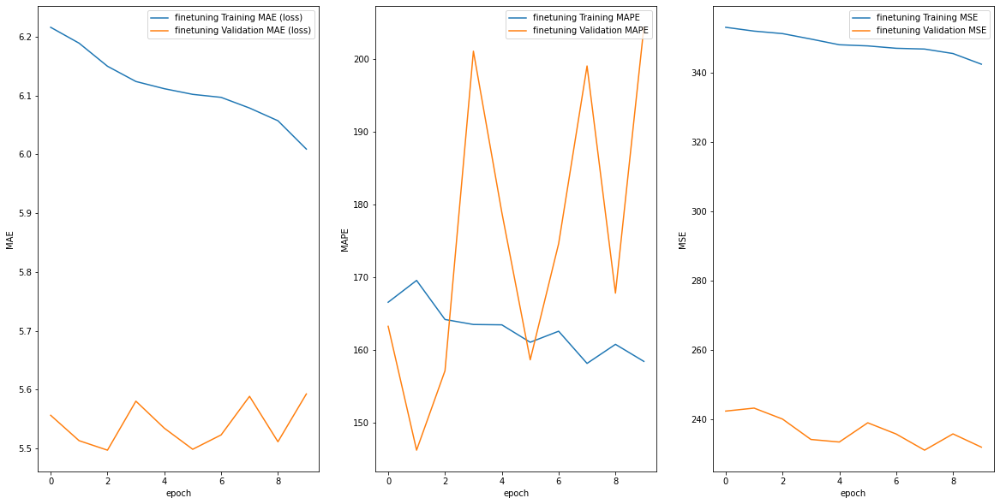

Average finetuning training MAE is 6.113477277755737
Average finetuning validation MAE is 5.539559173583984
Average finetuning training MAPE is 162.7826889038086
Average finetuning validation MAPE is 175.07898559570313
Average finetuning training MSE is 348.3476928710937
Average finetuning validation MSE is 236.6934066772461


In [ ]:
plt.figure(figsize=(20,10))

plt.subplot(1, 3, 1)
plt.ylabel('MAE')
plt.xlabel('epoch')
plt.plot(Model_finetuning_history.history['mae'], label='finetuning Training MAE (loss)')
plt.plot(Model_finetuning_history.history['val_mae'], label='finetuning Validation MAE (loss)')
plt.legend(loc='upper right')

plt.subplot(1, 3, 2)
plt.ylabel('MAPE')
plt.xlabel('epoch')
plt.plot(Model_finetuning_history.history['mape'], label='finetuning Training MAPE')
plt.plot(Model_finetuning_history.history['val_mape'], label='finetuning Validation MAPE')
plt.legend(loc='upper right')

plt.subplot(1, 3, 3)
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.plot(Model_finetuning_history.history['mse'], label='finetuning Training MSE')
plt.plot(Model_finetuning_history.history['val_mse'], label='finetuning Validation MSE')
plt.legend(loc='upper right')

plt.show()

print('Average finetuning training MAE is {}'.format(np.average(Model_finetuning_history.history['mae'])))
print('Average finetuning validation MAE is {}'.format(np.average(Model_finetuning_history.history['val_mae'])))

print('Average finetuning training MAPE is {}'.format(np.average(Model_finetuning_history.history['mape'])))
print('Average finetuning validation MAPE is {}'.format(np.average(Model_finetuning_history.history['val_mape'])))

print('Average finetuning training MSE is {}'.format(np.average(Model_finetuning_history.history['mse'])))
print('Average finetuning validation MSE is {}'.format(np.average(Model_finetuning_history.history['val_mse'])))

## Evaluation

In [ ]:
finetune_model = keras.models.load_model('/content/drive/MyDrive/Colab_Notebooks/Models/finetune_model_VGG19.pb/')

In [ ]:
finetune_model = keras.models.load_model('/content/drive/MyDrive/Colab_Notebooks/Models/VGG19.pb/')

In [ ]:
X_test = []
root_dir = '/content/drive/MyDrive/Colab_Notebooks/recipes/'
df['photo_test'] = df['photo_id'] + '.png'
data_test = df[df['photo_test'].isin(os.listdir(os.path.join(root_dir, 'test')))]
data_test = data_test.reset_index()
data_test.drop(columns = 'index', inplace = True)
data_test


,photo_id,url,may_be,likes,timestamp,scraped_at,diff,tag_healthy,tag_tasty,tag_dinner,tag_vegan,tag_breakfast,tag_lunch,tag_dessert,tag_baking,tag_cake,tag_easyrecipes,tag_chocolate,tag_vegetarian,tag_sweet,tag_pasta,tag_diet,tag_fitness,tag_glutenfree,tag_chicken,tag_weightloss,tag_veganfood,tag_plantbased,tag_cheese,tag_italianfood,tag_salad,tag_keto,tag_pastry,tag_fresh,tag_snack,tag_cookies,tag_comfortfood,tag_lowcarb,tag_protein,tag_bread,...,tag_cheesecake,tag_snacks,tag_ilovefood,tag_food52,tag_foodbloggers,tag_family,tag_avocado,tag_cakes,tag_curry,tag_banana,tag_gastronomy,tag_chocolat,tag_oats,tag_bbq,tag_italia,tag_pastalover,tag_icecream,tag_spicy,tag_smoothie,tag_asianfood,tag_garlic,tag_streetfood,tag_travel,tag_salmon,tag_egg,tag_oatmeal,tag_natural,tag_beef,tag_noodles,tag_italian,tag_drinks,tag_steak,tag_sandwich,tag_strawberry,photo,photo_train,time,likes per hour,error,photo_test
0,CMPELQqh_nh,https://www.instagram.com/p/CMPELQqh_nh/,dessert and indoor,3,2021-03-10T10:47:18,2021-03-10T11:48:52,1.03,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPELQqh_nh.png,1.03,2.912621,-4.374624,CMPELQqh_nh.png
1,CMPDzLzrRvZ,https://www.instagram.com/p/CMPDzLzrRvZ/,food,72,2021-03-10T10:46:44,2021-03-10T11:49:47,1.05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPDzLzrRvZ.png,1.05,68.571429,61.284183,CMPDzLzrRvZ.png
2,CMPDgWvHEDQ,https://www.instagram.com/p/CMPDgWvHEDQ/,food and indoor,9,2021-03-10T10:41:26,2021-03-10T11:50:25,1.15,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPDgWvHEDQ.png,1.15,7.826087,0.538842,CMPDgWvHEDQ.png
3,CMPDXBNgley,https://www.instagram.com/p/CMPDXBNgley/,food and indoor,1,2021-03-10T10:40:10,2021-03-10T11:51:05,1.18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPDXBNgley.png,1.18,0.847458,-6.439788,CMPDXBNgley.png
4,CMPDLoZlOTV,https://www.instagram.com/p/CMPDLoZlOTV/,food,6,2021-03-10T10:38:37,2021-03-10T11:51:22,1.21,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPDLoZlOTV.png,1.21,4.958678,-2.328567,CMPDLoZlOTV.png
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1125,CMsQGf6gZ7k,https://www.instagram.com/p/CMsQGf6gZ7k/,food,34,2021-03-21T20:33:12,2021-03-22T10:03:24,13.50,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMsQGf6gZ7k.png,13.50,2.518519,-4.768727,CMsQGf6gZ7k.png
1126,CMsP-0LnsxJ,https://www.instagram.com/p/CMsP-0LnsxJ/,coffee cup and indoor,29,2021-03-21T18:48:26,2021-03-22T10:03:44,15.26,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMsP-0LnsxJ.png,15.26,1.900393,-5.386852,CMsP-0LnsxJ.png
1127,CMsP6TpJDzM,https://www.instagram.com/p/CMsP6TpJDzM/,dessert and indoor,10,2021-03-21T18:47:49,2021-03-22T10:03:58,15.27,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0

In [ ]:
directory = '/content/drive/MyDrive/Colab_Notebooks/recipes/test/'

# size of the image: 224*224 pixels
pic_size = 224
rescale_size = 1./255

test_datagen = ImageDataGenerator(
    rescale = rescale_size # rescales the pixels such that their brightness ranges from 0 to 1
)

test_generator=test_datagen.flow_from_dataframe(
    data_test, 
    directory,
    shuffle=False, # Need to yield the images in “order”, to predict the outputs and match them with their unique filenames.
    x_col = 'photo_test',
    y_col = 'likes per hour',
    target_size=(pic_size, pic_size),
    batch_size = 32,
    class_mode='raw')

Found 1130 validated image filenames.


In [ ]:
prediction = finetune_model.predict(test_generator)
print(prediction)
evaluation = finetune_model.evaluate(test_generator)
print('Average test MAE is {}'.format(str(evaluation[0])))
print('Average test MAPE is {}'.format(str(evaluation[1])))
print('Average test MSE is {}'.format(str(evaluation[3])))

[[3.4340029]
 [4.7171707]
 [3.1157227]
 ...
 [2.7804122]
 [2.6929722]
 [2.4826322]]
36/36 [==============================] - 22s 592ms/step - loss: 6.1005 - mape: 186.4339 - mae: 6.1005 - mse: 311.2781
Average test MAE is 6.100512504577637
Average test MAPE is 186.43394470214844
Average test MSE is 311.2781066894531


(224, 224, 3)


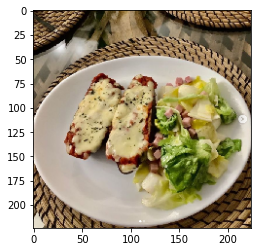

Predicted number of likes per hour for image CMPDgWvHEDQ.png is 3.1157236
Actual number of likes per hour for image CMPDgWvHEDQ.png is 7.82608695652174


In [ ]:
index = 2
image, label = test_generator._get_batches_of_transformed_samples(np.array([index]))
image_name = test_generator.filenames[index]
image = image[0]
print(image.shape)
plt.imshow(image)
plt.show()

img = image.reshape(1, 224, 224, 3)
img_predict = finetune_model.predict(img)


print('Predicted number of likes per hour for image {} is {}'.format(image_name, str(img_predict[0][0])))
print('Actual number of likes per hour for image {} is {}'.format(image_name, str(data_test['likes per hour'][index])))



### Baseline Model

In [ ]:
root_dir = '/content/drive/MyDrive/Colab_Notebooks/recipes/'
df['photo_train'] = df['photo_id'] + '.png'
data_train = df[df['photo_train'].isin(os.listdir(os.path.join(root_dir, 'train')))]
data_train = data_train.reset_index()
data_train.drop(columns = 'index', inplace = True)
data_train

,photo_id,url,may_be,likes,timestamp,scraped_at,diff,tag_healthy,tag_tasty,tag_dinner,tag_vegan,tag_breakfast,tag_lunch,tag_dessert,tag_baking,tag_cake,tag_easyrecipes,tag_chocolate,tag_vegetarian,tag_sweet,tag_pasta,tag_diet,tag_fitness,tag_glutenfree,tag_chicken,tag_weightloss,tag_veganfood,tag_plantbased,tag_cheese,tag_italianfood,tag_salad,tag_keto,tag_pastry,tag_fresh,tag_snack,tag_cookies,tag_comfortfood,tag_lowcarb,tag_protein,tag_bread,...,tag_ketodiet,tag_lemon,tag_cheesecake,tag_snacks,tag_ilovefood,tag_food52,tag_foodbloggers,tag_family,tag_avocado,tag_cakes,tag_curry,tag_banana,tag_gastronomy,tag_chocolat,tag_oats,tag_bbq,tag_italia,tag_pastalover,tag_icecream,tag_spicy,tag_smoothie,tag_asianfood,tag_garlic,tag_streetfood,tag_travel,tag_salmon,tag_egg,tag_oatmeal,tag_natural,tag_beef,tag_noodles,tag_italian,tag_drinks,tag_steak,tag_sandwich,tag_strawberry,photo,photo_train,time,likes per hour
0,CMPEHqppR-t,https://www.instagram.com/p/CMPEHqppR-t/,pasta and indoor,3,2021-03-10T10:46:48,2021-03-10T11:48:59,1.04,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPEHqppR-t.png,1.04,2.884615
1,CMPEBY9Buko,https://www.instagram.com/p/CMPEBY9Buko/,cake and indoor,2,2021-03-10T10:45:57,2021-03-10T11:49:08,1.05,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPEBY9Buko.png,1.05,1.904762
2,CMPEAvhF9i1,https://www.instagram.com/p/CMPEAvhF9i1/,food,1,2021-03-10T10:45:52,2021-03-10T11:49:12,1.06,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPEAvhF9i1.png,1.06,0.943396
3,CMPD73jJssJ,https://www.instagram.com/p/CMPD73jJssJ/,dessert,2,2021-03-10T10:45:12,2021-03-10T11:49:16,1.07,0,0,0,0,0,0,1,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPD73jJssJ.png,1.07,1.869159
4,CMPD5YEAmHv,https://www.instagram.com/p/CMPD5YEAmHv/,food and indoor,2,2021-03-10T10:44:51,2021-03-10T11:49:25,1.08,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMPD5YEAmHv.png,1.08,1.851852
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10154,CMsOtSZhtSx,https://www.instagram.com/p/CMsOtSZhtSx/,dessert and indoor,10,2021-03-21T18:59:16,2021-03-22T10:08:38,15.16,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMsOtSZhtSx.png,15.16,0.659631
10155,CMsOstJAXEJ,https://www.instagram.com/p/CMsOstJAXEJ/,strawberry,16,2021-03-21T18:37:13,2021-03-22T10:08:42,15.52,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMsOstJAXEJ.png,15.52,1.030928
10156,CMsOrPOrSkl,https://www.instagram.com/p/CMsOrPOrSkl/,food,15,2021-03-21T18:56:11,2021-03-22T10:08:50,15.21,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,/content/drive/MyDrive/Colab_Notebooks/recipes...,CMsOrPOrSkl.png,15.21,0.986193
10157,CMsOnHuFxoF,https://www.instagram.com/

In [ ]:
base_pred = data_train['likes per hour'].mean()
data_train['error'] = data_train['likes per hour'] - base_pred
MAE_train = abs(data_train['error']).sum()/len(data_train)
data_test['error'] = data_test['likes per hour'] - base_pred
MAE_test = abs(data_test['error']).sum()/len(data_test)
print('The baseline prediction is {:.2f} likes per hour'.format(base_pred))
print('The MAE on the training set is {:.2f}'.format(MAE_train))
print('The MAE on the test set is {:.2f}'.format(MAE_test))

The baseline prediction is 7.28 likes per hour
The MAE on the training set is 7.67
The MAE on the test set is 7.61


# Interpretation

In [ ]:
layer_outputs = [layer.output for layer in model.layers[1:-5]] 
# Extracts the outputs of the convolution and pooling layers
activation_model = models.Model(inputs=model.input, outputs=layer_outputs) # Creates a model that will return these outputs, given the model input


In [ ]:
# This will return a list of 5 Numpy arrays:
# one array per layer activation
activations = activation_model.predict(img_tensor)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


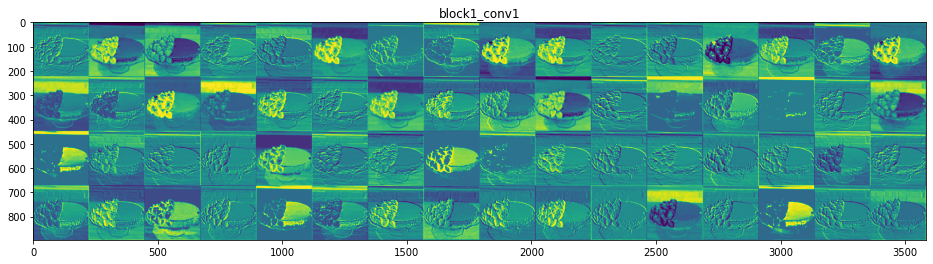

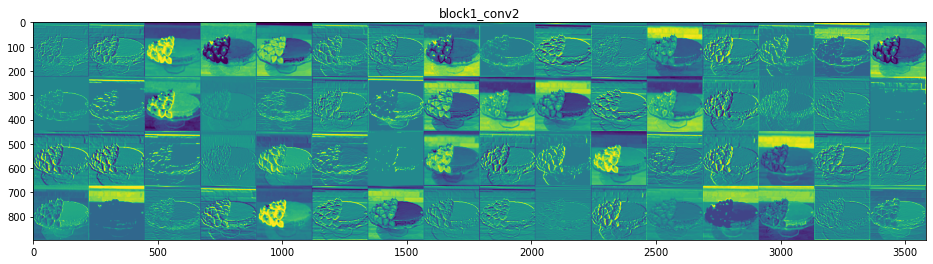

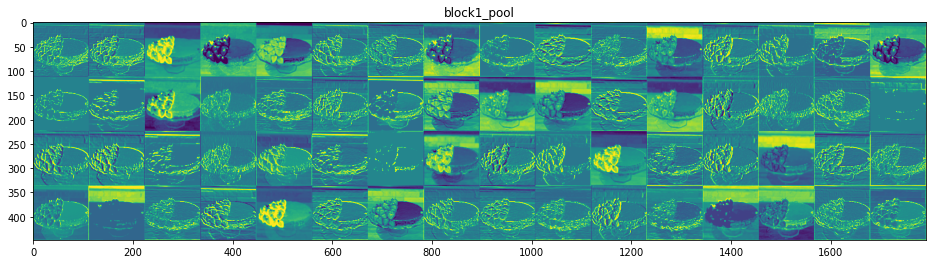

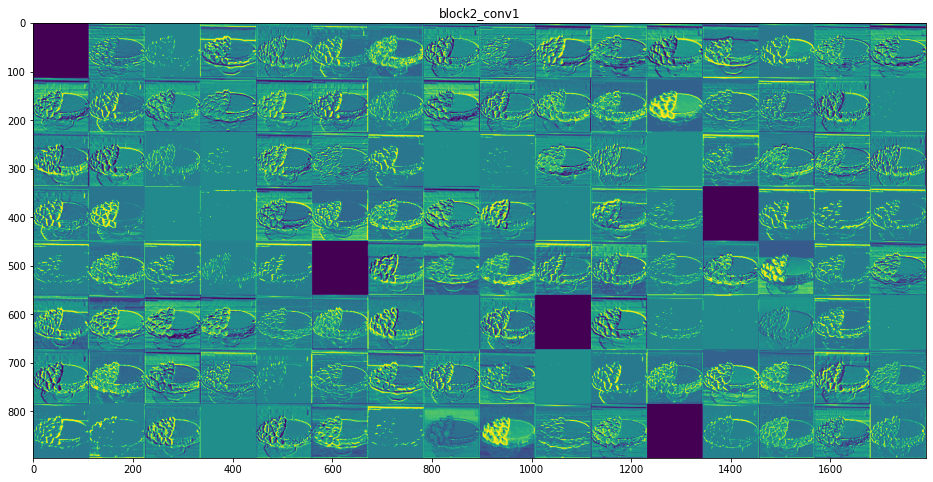

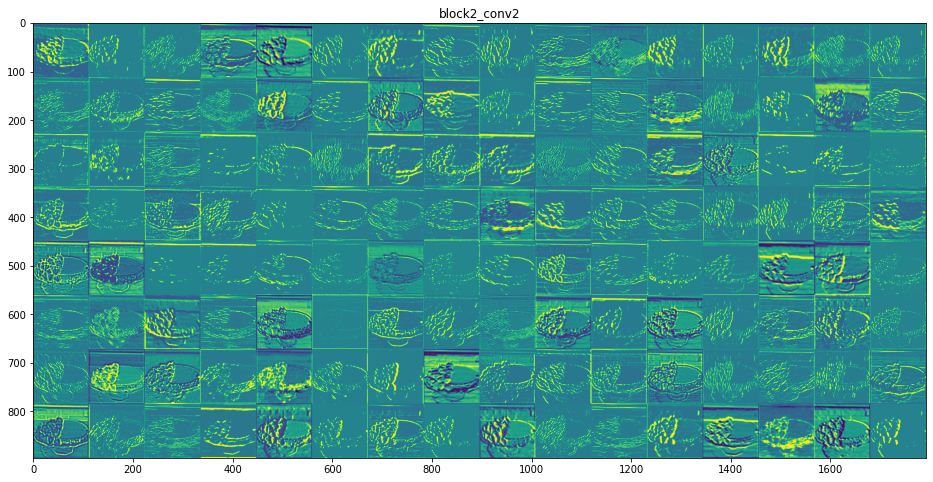

...

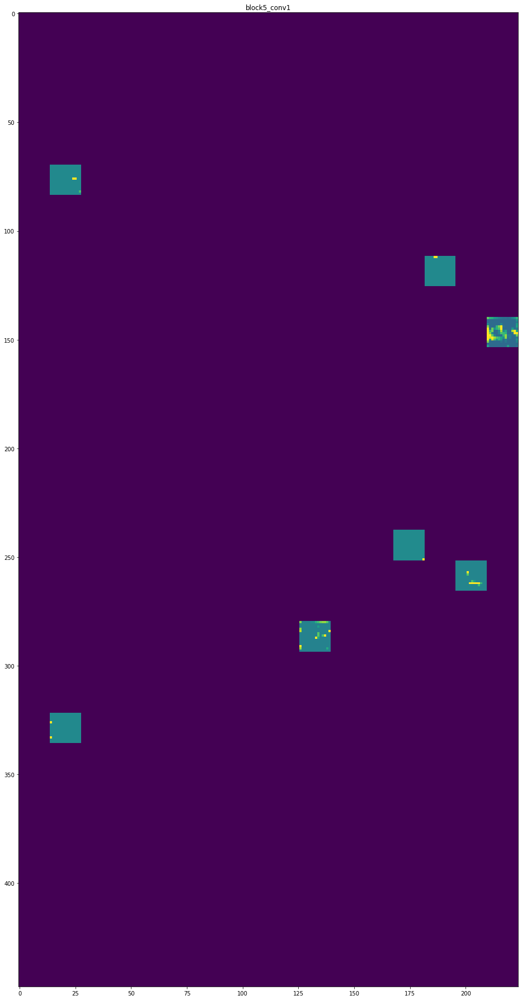

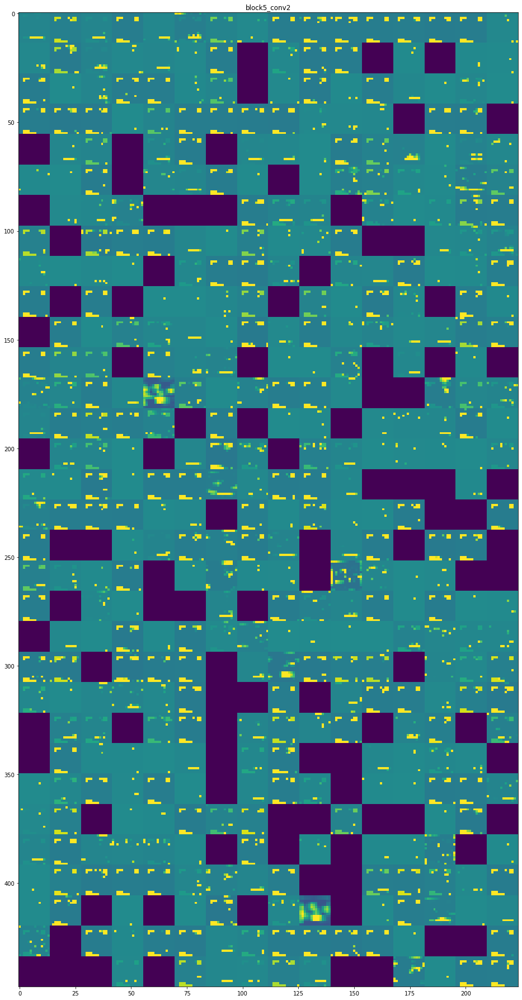

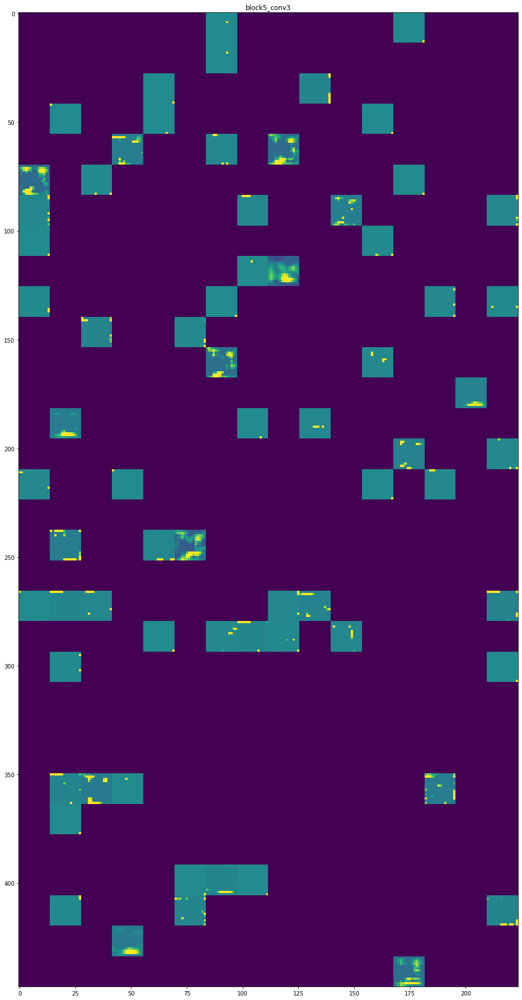

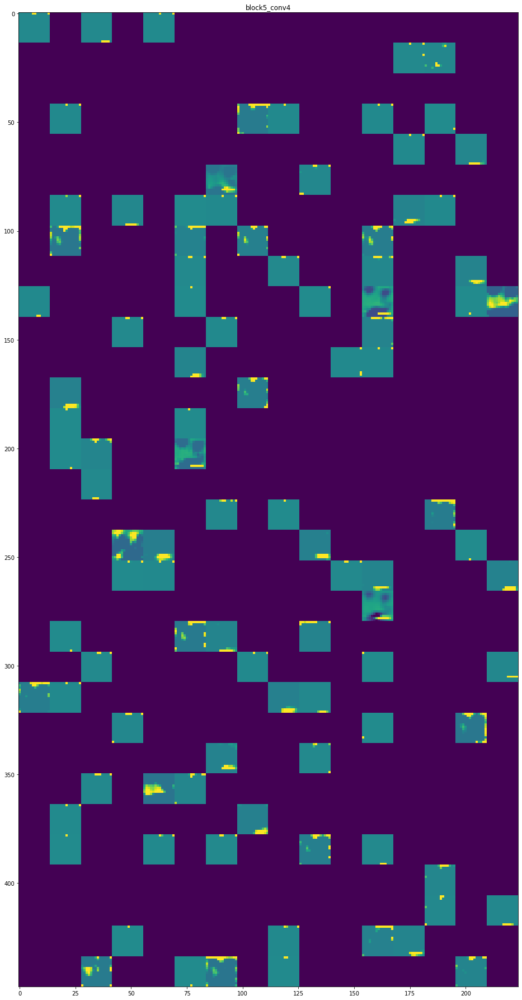

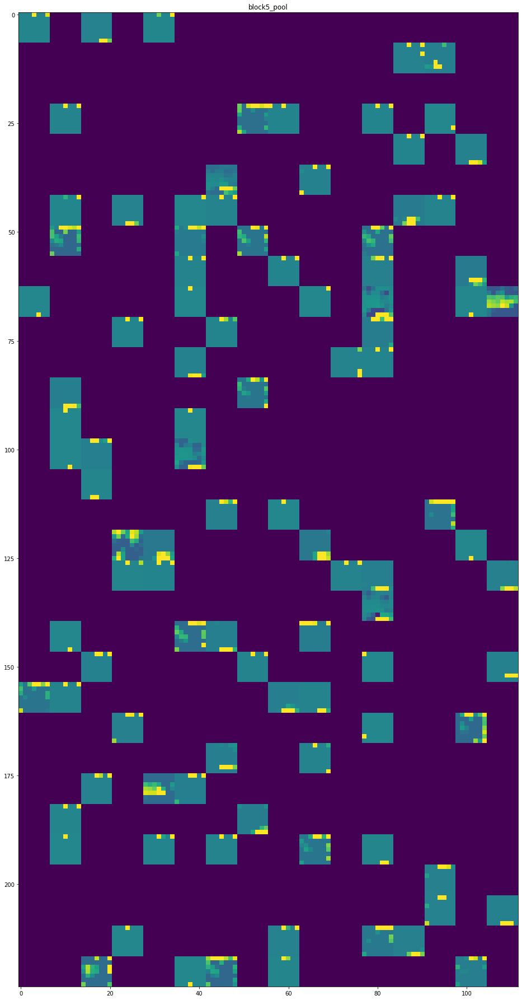

In [ ]:
layer_names = []
for layer in model.layers[1:-5]:
    layer_names.append(layer.name) # Names of the layers, so you can have them as part of your plot

images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations): # Displays the feature maps
    n_features = layer_activation.shape[-1] # Number of features in the feature map
    size = layer_activation.shape[1] #The feature map has shape (1, size, size, n_features).
    n_cols = n_features // images_per_row # Tiles the activation channels in this matrix
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols): # Tiles each filter into a big horizontal grid
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            channel_image -= channel_image.mean() # Post-processes the feature to make it visually palatable
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, # Displays the grid
                         row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')